di project ini kita menggunakan data belanja customer beberapa bulan kebelakang dari Online Retail.csv
nah dari dat aini kita mencoba mengklompokan/clustering menggunakan metode RFM selain itu kita juga akan mengclustering menggunakan
k-means dan dbscan lewat dua variabel saja,misal r dan m,atau m dan f,dari hasil segmentasi tadi

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [1]:
import pandas as pd
data = pd.read_excel("Online Retail.xlsx")

In [2]:
data.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom


In [4]:
data.shape

(541909, 8)

cek ada fitur yang nan ga,dan ada ga yang diatas 30 persen

In [5]:
tab_info=pd.DataFrame(data.dtypes).T.rename(index={0:'column type'})
tab_info=tab_info.append(pd.DataFrame(data.isnull().sum()).T.rename(index={0:'null values (nb)'}))
tab_info=tab_info.append(pd.DataFrame(data.isnull().sum()/data.shape[0]*100).T.
                         rename(index={0:'null values (%)'}))
display(tab_info)

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
column type,object,object,object,int64,datetime64[ns],float64,float64,object
null values (nb),0,0,1454,0,0,0,135080,0
null values (%),0,0,0.268311,0,0,0,24.9267,0


karena data yang nan adalah customerID dan jumlahnya dibawah 30 persen,karena customerID tidak bisa kita isi berdasarkan apapun makanya kita drop saja

In [6]:
data.dropna(subset=['CustomerID'],inplace=True)

In [7]:
data.shape

(406829, 8)

data terbaru dari 54rb row menjadi 40rb

In [8]:
tab_info=pd.DataFrame(data.dtypes).T.rename(index={0:'column type'})
tab_info=tab_info.append(pd.DataFrame(data.isnull().sum()).T.rename(index={0:'null values (nb)'}))
tab_info=tab_info.append(pd.DataFrame(data.isnull().sum()/data.shape[0]*100).T.
                         rename(index={0:'null values (%)'}))
display(tab_info)

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
column type,object,object,object,int64,datetime64[ns],float64,float64,object
null values (nb),0,0,0,0,0,0,0,0
null values (%),0,0,0,0,0,0,0,0


data sudah bersih semua,sekarang kita cek type dari setiap kolom sudah sesuai belum


customer id harusnya object

In [9]:
data['CustomerID']= data['CustomerID'].astype(str)

In [10]:
tab_info=pd.DataFrame(data.dtypes).T.rename(index={0:'column type'})
tab_info=tab_info.append(pd.DataFrame(data.isnull().sum()).T.rename(index={0:'null values (nb)'}))
tab_info=tab_info.append(pd.DataFrame(data.isnull().sum()/data.shape[0]*100).T.
                         rename(index={0:'null values (%)'}))
display(tab_info)

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
column type,object,object,object,int64,datetime64[ns],float64,object,object
null values (nb),0,0,0,0,0,0,0,0
null values (%),0,0,0,0,0,0,0,0


In [11]:
data.shape

(406829, 8)

In [12]:
# buang data duplicate

In [13]:
data.drop_duplicates(inplace=True)

In [14]:
data.shape

(401604, 8)

seperti dijelaskan di dataset,untuk invoice C menandakan bahwa ada orderan yang dicancel,maka dari itu saya ingin menyisihkan data tersebut dan memasukannya ke dalam ordercancel,yang akan kita analisis lebih jauh nantinya

In [15]:
ordercancel=data[data['InvoiceNo'].str[0:1] =='C']
ordercancel

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
141,C536379,D,Discount,-1,2010-12-01 09:41:00,27.50,14527.0,United Kingdom
154,C536383,35004C,SET OF 3 COLOURED FLYING DUCKS,-1,2010-12-01 09:49:00,4.65,15311.0,United Kingdom
235,C536391,22556,PLASTERS IN TIN CIRCUS PARADE,-12,2010-12-01 10:24:00,1.65,17548.0,United Kingdom
236,C536391,21984,PACK OF 12 PINK PAISLEY TISSUES,-24,2010-12-01 10:24:00,0.29,17548.0,United Kingdom
237,C536391,21983,PACK OF 12 BLUE PAISLEY TISSUES,-24,2010-12-01 10:24:00,0.29,17548.0,United Kingdom
...,...,...,...,...,...,...,...,...
540449,C581490,23144,ZINC T-LIGHT HOLDER STARS SMALL,-11,2011-12-09 09:57:00,0.83,14397.0,United Kingdom
541541,C581499,M,Manual,-1,2011-12-09 10:28:00,224.69,15498.0,United Kingdom
541715,C581568,21258,VICTORIAN SEWING BOX LARGE,-5,2011-12-09 11:57:00,10.95,15311.0,United Kingdom
541716,C581569,84978,HANGING HEART JAR T-LIGHT HOLDER,-1,2011-12-09 11:58:00,1.25,17315.0,United Kingdom


In [16]:
#lalu saya memfilter data yang bukan ordercancel

In [17]:
data=data[data['InvoiceNo'].str[0:1] !='C']
data

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2011-12-09 12:50:00,0.85,12680.0,France
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2011-12-09 12:50:00,2.10,12680.0,France
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2011-12-09 12:50:00,4.15,12680.0,France
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2011-12-09 12:50:00,4.15,12680.0,France


In [18]:
data.shape

(392732, 8)

## check bisnis logicnya



*1.unit price ga mungkin minus*
2.quantity ga mungkin minus

In [19]:
data['Quantity'].min()

1

In [20]:
data['UnitPrice'].min()

0.0

filter aja deh yang kuantitasnya minus


In [21]:
data = data[(data['Quantity']>=0)]

In [22]:
data

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2011-12-09 12:50:00,0.85,12680.0,France
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2011-12-09 12:50:00,2.10,12680.0,France
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2011-12-09 12:50:00,4.15,12680.0,France
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2011-12-09 12:50:00,4.15,12680.0,France


In [23]:
#selanjutnya saya ingin melihat aapa aja produk yang hargannya 0

In [24]:
#produk yang harganya 0 bisa kita asumsikan ada produk yang gratis di berikan oleh perusahaan,misalkan kita beli barang A terus gratis piring cantik,dan promo promo sejenisnya

In [25]:
#karena analisis kita basisnya adalah RFM,yang mana nilai M atau monetary itu berdasarkan total sales dari suatu pembelian,yaitu quantity dikali dengan unitprice,maka dari itu produk yang harganya 0 tidak akan memberikan nilai pada MOnetary kita,jadi sebaiknya kita sisihkan saja dulu

#dan juga data yang harganya 0 juga tidak terlalu banyak hanya 40 riwayat pembelian

In [26]:
nol=data[(data['UnitPrice']==0)]

In [27]:
nol

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
9302,537197,22841,ROUND CAKE TIN VINTAGE GREEN,1,2010-12-05 14:02:00,0.0,12647.0,Germany
33576,539263,22580,ADVENT CALENDAR GINGHAM SACK,4,2010-12-16 14:36:00,0.0,16560.0,United Kingdom
40089,539722,22423,REGENCY CAKESTAND 3 TIER,10,2010-12-21 13:45:00,0.0,14911.0,EIRE
47068,540372,22090,PAPER BUNTING RETROSPOT,24,2011-01-06 16:41:00,0.0,13081.0,United Kingdom
47070,540372,22553,PLASTERS IN TIN SKULLS,24,2011-01-06 16:41:00,0.0,13081.0,United Kingdom
56674,541109,22168,ORGANISER WOOD ANTIQUE WHITE,1,2011-01-13 15:10:00,0.0,15107.0,United Kingdom
86789,543599,84535B,FAIRY CAKES NOTEBOOK A6 SIZE,16,2011-02-10 13:08:00,0.0,17560.0,United Kingdom
130188,547417,22062,CERAMIC BOWL WITH LOVE HEART DESIGN,36,2011-03-23 10:25:00,0.0,13239.0,United Kingdom
139453,548318,22055,MINI CAKE STAND HANGING STRAWBERY,5,2011-03-30 12:45:00,0.0,13113.0,United Kingdom
145208,548871,22162,HEART GARLAND RUSTIC PADDED,2,2011-04-04 14:42:00,0.0,14410.0,United Kingdom


In [28]:
nol.shape

(40, 8)

In [29]:
# filter data yaang harganya ga 0

In [30]:
data=data[(data['UnitPrice']!=0)]  

In [31]:
data

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2011-12-09 12:50:00,0.85,12680.0,France
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2011-12-09 12:50:00,2.10,12680.0,France
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2011-12-09 12:50:00,4.15,12680.0,France
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2011-12-09 12:50:00,4.15,12680.0,France


In [32]:
data.shape

(392692, 8)

# EDA

In [33]:
#mengubah tipe kolom invoice date ke datetime

In [34]:
data['InvoiceDate'] = pd.to_datetime(data['InvoiceDate'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [35]:
data

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2011-12-09 12:50:00,0.85,12680.0,France
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2011-12-09 12:50:00,2.10,12680.0,France
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2011-12-09 12:50:00,4.15,12680.0,France
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2011-12-09 12:50:00,4.15,12680.0,France


In [36]:
#dari kolom datetime tadi saya hanya ingin menampilkan hari bulan dan tanggal pada kolom baru

In [37]:
data['date_Mon_Year'] = data['InvoiceDate'].dt.strftime('%d-%b-%Y')

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [38]:
data

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,date_Mon_Year
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom,01-Dec-2010
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,01-Dec-2010
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom,01-Dec-2010
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,01-Dec-2010
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,01-Dec-2010
...,...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2011-12-09 12:50:00,0.85,12680.0,France,09-Dec-2011
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2011-12-09 12:50:00,2.10,12680.0,France,09-Dec-2011
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2011-12-09 12:50:00,4.15,12680.0,France,09-Dec-2011
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2011-12-09 12:50:00,4.15,12680.0,France,09-Dec-2011


## bulan penjualan terbaik

In [39]:
#lalu saya ingin tahu bulan penjualan terbaik maka dari itu saya buat kolom baru yang hanya mengambil bulannya saja

In [40]:
data['Month'] = data['date_Mon_Year'].str[3:6]

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [41]:
data

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,date_Mon_Year,Month
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom,01-Dec-2010,Dec
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,01-Dec-2010,Dec
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom,01-Dec-2010,Dec
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,01-Dec-2010,Dec
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,01-Dec-2010,Dec
...,...,...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2011-12-09 12:50:00,0.85,12680.0,France,09-Dec-2011,Dec
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2011-12-09 12:50:00,2.10,12680.0,France,09-Dec-2011,Dec
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2011-12-09 12:50:00,4.15,12680.0,France,09-Dec-2011,Dec
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2011-12-09 12:50:00,4.15,12680.0,France,09-Dec-2011,Dec


In [42]:
#membuat kolom baru yaitu total amount

In [43]:
data['TotalAmount'] =data['Quantity'] * data['UnitPrice']

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [44]:
data

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,date_Mon_Year,Month,TotalAmount
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom,01-Dec-2010,Dec,15.30
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,01-Dec-2010,Dec,20.34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom,01-Dec-2010,Dec,22.00
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,01-Dec-2010,Dec,20.34
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,01-Dec-2010,Dec,20.34
...,...,...,...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2011-12-09 12:50:00,0.85,12680.0,France,09-Dec-2011,Dec,10.20
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2011-12-09 12:50:00,2.10,12680.0,France,09-Dec-2011,Dec,12.60
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2011-12-09 12:50:00,4.15,12680.0,France,09-Dec-2011,Dec,16.60
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2011-12-09 12:50:00,4.15,12680.0,France,09-Dec-2011,Dec,16.60


In [45]:
results=data.groupby('Month').sum()

In [46]:
results

,Quantity,UnitPrice,TotalAmount
Month,,,
Apr,291366,78543.481,468374.331
Aug,397373,78877.090,644051.040
Dec,597825,127239.300,1087613.170
Feb,265027,62619.480,446084.920
Jan,348473,66234.650,568101.310
Jul,367360,75454.521,598962.901
Jun,363014,84602.660,660046.050
Mar,347582,87864.790,594081.760
May,372864,101500.910,677355.150


In [47]:
results.sort_values(by='TotalAmount')

,Quantity,UnitPrice,TotalAmount
Month,,,
Feb,265027,62619.480,446084.920
Apr,291366,78543.481,468374.331
Jan,348473,66234.650,568101.310
Mar,347582,87864.790,594081.760
Jul,367360,75454.521,598962.901
Aug,397373,78877.090,644051.040
Jun,363014,84602.660,660046.050
May,372864,101500.910,677355.150
Sep,543652,118160.322,950690.202


In [48]:
results = results.reset_index()

In [49]:
results

,Month,Quantity,UnitPrice,TotalAmount
0,Apr,291366,78543.481,468374.331
1,Aug,397373,78877.090,644051.040
2,Dec,597825,127239.300,1087613.170
3,Feb,265027,62619.480,446084.920
4,Jan,348473,66234.650,568101.310
5,Jul,367360,75454.521,598962.901
6,Jun,363014,84602.660,660046.050
7,Mar,347582,87864.790,594081.760
8,May,372864,101500.910,677355.150
9,Nov,665923,182340.090,1156205.610


In [50]:
hasil = results.sort_values(by='TotalAmount')


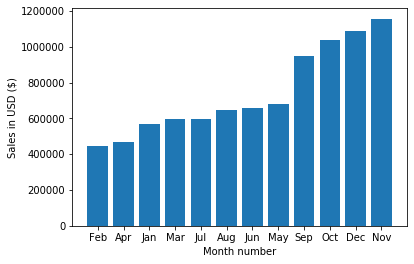

In [51]:
plt.bar(hasil['Month'],hasil['TotalAmount'])
plt.xticks(results['Month'])
plt.ylabel('Sales in USD ($)')
plt.xlabel('Month number')
plt.show()

bisa dilihat penjualan terbaik ada dibulan september sampai november broo

terus kita lihat lagi nih jam jam paling sering lakunya tuh jamb berapa sih

In [52]:
data['Hour'] = pd.to_datetime(data['InvoiceDate']).dt.hour
data['Minute'] = pd.to_datetime(data['InvoiceDate']).dt.minute
data.head()

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,date_Mon_Year,Month,TotalAmount,Hour,Minute
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom,01-Dec-2010,Dec,15.30,8,26
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,01-Dec-2010,Dec,20.34,8,26
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom,01-Dec-2010,Dec,22.00,8,26
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,01-Dec-2010,Dec,20.34,8,26
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,01-Dec-2010,Dec,20.34,8,26


In [53]:
hours = [hour for hour, df in data.groupby(['Hour'])]

In [54]:
hours

[6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20]

In [55]:
jam =data.groupby(['Hour']).count()
jam

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,date_Mon_Year,Month,TotalAmount,Minute
Hour,,,,,,,,,,,,
6,1,1,1,1,1,1,1,1,1,1,1,1
7,379,379,379,379,379,379,379,379,379,379,379,379
8,8687,8687,8687,8687,8687,8687,8687,8687,8687,8687,8687,8687
9,21927,21927,21927,21927,21927,21927,21927,21927,21927,21927,21927,21927
10,37773,37773,37773,37773,37773,37773,37773,37773,37773,37773,37773,37773
11,48365,48365,48365,48365,48365,48365,48365,48365,48365,48365,48365,48365
12,70938,70938,70938,70938,70938,70938,70938,70938,70938,70938,70938,70938
13,63019,63019,63019,63019,63019,63019,63019,63019,63019,63019,63019,63019
14,53251,53251,53251,53251,53251,53251,53251,53251,53251,53251,53251,53251


In [56]:
jam.sort_values(by='InvoiceNo')

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,date_Mon_Year,Month,TotalAmount,Minute
Hour,,,,,,,,,,,,
6,1,1,1,1,1,1,1,1,1,1,1,1
7,379,379,379,379,379,379,379,379,379,379,379,379
20,778,778,778,778,778,778,778,778,778,778,778,778
18,2895,2895,2895,2895,2895,2895,2895,2895,2895,2895,2895,2895
19,3233,3233,3233,3233,3233,3233,3233,3233,3233,3233,3233,3233
8,8687,8687,8687,8687,8687,8687,8687,8687,8687,8687,8687,8687
17,12941,12941,12941,12941,12941,12941,12941,12941,12941,12941,12941,12941
9,21927,21927,21927,21927,21927,21927,21927,21927,21927,21927,21927,21927
16,23715,23715,23715,23715,23715,23715,23715,23715,23715,23715,23715,23715


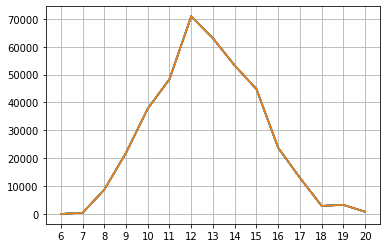

In [57]:
plt.plot(hours,data.groupby(['Hour']).count())
plt.xticks(hours)
plt.grid()
plt.show()

produk terbaik

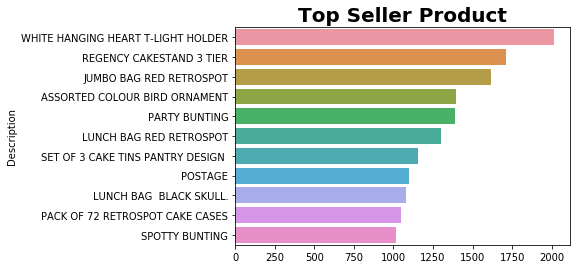

In [58]:
splot1 = sns.countplot(y=data['Description'],order=data['Description'].value_counts().iloc[:11].index)

plt.xlabel(None)
plt.title('Top Seller Product', fontsize=20, weight='bold')
plt.xticks(rotation=0)
plt.show()

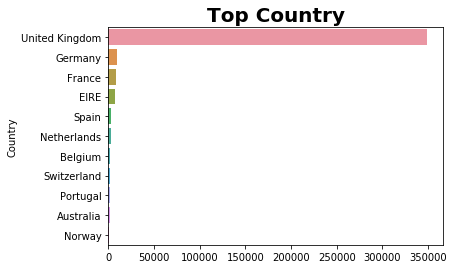

In [59]:
splot1 = sns.countplot(y=data['Country'],order=data['Country'].value_counts().iloc[:11].index)

plt.xlabel(None)
plt.title('Top Country', fontsize=20, weight='bold')
plt.xticks(rotation=0)
plt.show()

# RFM #Recency = Latest Date - Last Inovice Data, Frequency = count of invoice no. of transaction(s), Monetary = Sum of Total 



In [60]:

import datetime as dt

In [61]:
## cari data invoice terakir dan set hari terakir pake lastdate

In [62]:
data['InvoiceDate'].max()

Timestamp('2011-12-09 12:50:00')

In [63]:
#setinggi latest datenya itu 1 hari setelah max date invoice

Latest_Date = dt.datetime(2011,12,12)

In [64]:
data

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,date_Mon_Year,Month,TotalAmount,Hour,Minute
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom,01-Dec-2010,Dec,15.30,8,26
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,01-Dec-2010,Dec,20.34,8,26
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom,01-Dec-2010,Dec,22.00,8,26
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,01-Dec-2010,Dec,20.34,8,26
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,01-Dec-2010,Dec,20.34,8,26
...,...,...,...,...,...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2011-12-09 12:50:00,0.85,12680.0,France,09-Dec-2011,Dec,10.20,12,50
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2011-12-09 12:50:00,2.10,12680.0,France,09-Dec-2011,Dec,12.60,12,50
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2011-12-09 12:50:00,4.15,12680.0,France,09-Dec-2011,Dec,16.60,12,50
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2011-12-09 12:50:00,4.15,12680.0,France,09-Dec-2011,Dec,16.60,12,50


In [65]:
#buat RFM Modelling untuk setiap customer
RFMScores = data.groupby('CustomerID').agg({'InvoiceDate': lambda x: (Latest_Date - x.max()).days, 
                                                'InvoiceNo': lambda x: len(x), 'TotalAmount': lambda x: x.sum()})


In [66]:
RFMScores

,InvoiceDate,InvoiceNo,TotalAmount
CustomerID,,,
12346.0,327,1,77183.60
12347.0,4,182,4310.00
12348.0,77,31,1797.24
12349.0,20,73,1757.55
12350.0,312,17,334.40
...,...,...,...
18280.0,279,10,180.60
18281.0,182,7,80.82
18282.0,9,12,178.05


In [67]:
tab_info=pd.DataFrame(RFMScores.dtypes).T.rename(index={0:'column type'})
tab_info=tab_info.append(pd.DataFrame(RFMScores.isnull().sum()).T.rename(index={0:'null values (nb)'}))
tab_info=tab_info.append(pd.DataFrame(RFMScores.isnull().sum()/RFMScores.shape[0]*100).T.
                         rename(index={0:'null values (%)'}))
display(tab_info)

,InvoiceDate,InvoiceNo,TotalAmount
column type,int64,int64,float64
null values (nb),0,0,0
null values (%),0,0,0


In [68]:
#ganti nama kolom to Recency, Frequency and Monetary
RFMScores.rename(columns={'InvoiceDate': 'Recency', 
                         'InvoiceNo': 'Frequency', 
                         'TotalAmount': 'Monetary'}, inplace=True)

In [69]:
RFMScores

,Recency,Frequency,Monetary
CustomerID,,,
12346.0,327,1,77183.60
12347.0,4,182,4310.00
12348.0,77,31,1797.24
12349.0,20,73,1757.55
12350.0,312,17,334.40
...,...,...,...
18280.0,279,10,180.60
18281.0,182,7,80.82
18282.0,9,12,178.05


In [70]:
RFMScores.reset_index().head()

,CustomerID,Recency,Frequency,Monetary
0,12346.0,327,1,77183.60
1,12347.0,4,182,4310.00
2,12348.0,77,31,1797.24
3,12349.0,20,73,1757.55
4,12350.0,312,17,334.40


In [71]:
#Descriptive Statistics (Recency)
RFMScores.Recency.describe()

count    4338.000000
mean       94.059474
std       100.012264
min         2.000000
25%        19.000000
50%        52.000000
75%       143.750000
max       375.000000
Name: Recency, dtype: float64

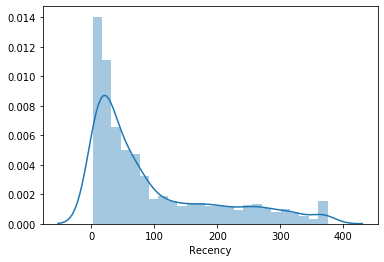

In [72]:
#Recency distribution plot
import seaborn as sns
x = RFMScores['Recency']

ax = sns.distplot(x)

In [73]:
## masih bagus kurvanya berati masih banyak customer yang beli akhir akhir ini
### recency semakin kecil semakin bagus

In [74]:
#Descriptive Statistics (Frequency)
RFMScores.Frequency.describe()

count    4338.000000
mean       90.523744
std       225.506968
min         1.000000
25%        17.000000
50%        41.000000
75%        98.000000
max      7676.000000
Name: Frequency, dtype: float64

In [75]:
# semakin tinggi semakin bagus

In [76]:
b=RFMScores[RFMScores['Frequency']<100]

In [77]:
c=b['Frequency']

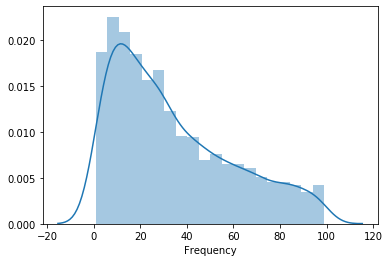

In [78]:
ax = sns.distplot(c)

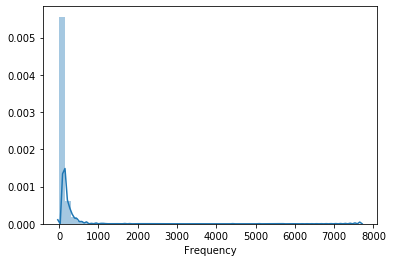

In [79]:
#Frequency distribution plot, taking observations which have frequency less than 1000
import seaborn as sns
x = RFMScores['Frequency']

ax = sns.distplot(x)

In [80]:
d=RFMScores[RFMScores['Frequency']>1000]
d

,Recency,Frequency,Monetary
CustomerID,,,
12748.0,2,4412,33053.19
13081.0,13,1024,28337.38
13089.0,4,1814,58762.08
13263.0,3,1667,7436.93
14056.0,3,1088,8152.71
14096.0,6,5111,65164.79
14156.0,11,1395,117210.08
14159.0,21,1175,4630.35
14298.0,10,1637,51527.30


In [81]:
e=d['Frequency']

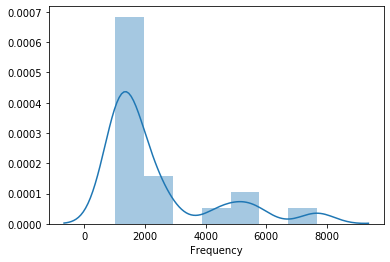

In [82]:
ax = sns.distplot(e)

In [83]:
RFMScores.Monetary.describe()

count      4338.000000
mean       2048.688081
std        8985.230220
min           3.750000
25%         306.482500
50%         668.570000
75%        1660.597500
max      280206.020000
Name: Monetary, dtype: float64

In [84]:
RFMScores.Monetary.mode()

0    76.32
dtype: float64

In [85]:
M1=RFMScores['Monetary']

In [86]:
M1

CustomerID
12346.0    77183.60
12347.0     4310.00
12348.0     1797.24
12349.0     1757.55
12350.0      334.40
             ...   
18280.0      180.60
18281.0       80.82
18282.0      178.05
18283.0     2045.53
18287.0     1837.28
Name: Monetary, Length: 4338, dtype: float64

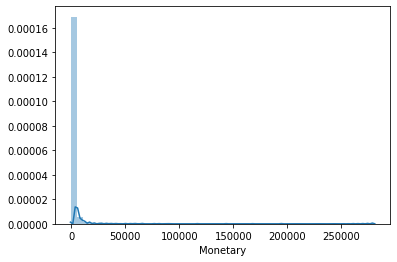

In [87]:
ax = sns.distplot(M1)

In [88]:
RFMScores

,Recency,Frequency,Monetary
CustomerID,,,
12346.0,327,1,77183.60
12347.0,4,182,4310.00
12348.0,77,31,1797.24
12349.0,20,73,1757.55
12350.0,312,17,334.40
...,...,...,...
18280.0,279,10,180.60
18281.0,182,7,80.82
18282.0,9,12,178.05


# Clustering with K-Means based on RFM

k-means clustering needs continuous variables and works best with relatively normally-distributed, standardized input variables. Therefore, data normalization and standardization was important here; otherwise, input variables with larger variances will tend to have correspondingly greater influence on the results.
logarithm transformation was used to the three input variables to reduce positive skew and then standardize them. We have seen the below plot earlier. It’s given below for comparison purpose.

Referensi:

https://medium.com/@ibobriakov/top-8-data-science-use-cases-in-sales-783f17f2128a

In [89]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import LabelEncoder
from sklearn import metrics
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import StandardScaler

In [90]:
from sklearn.cluster import KMeans
from sklearn.metrics import davies_bouldin_score,silhouette_score,silhouette_samples

In [91]:
cols = ['Recency', 'Frequency', 'Monetary']

In [92]:
# RFMScores['RecencyRS'] = StandardScaler().fit_transform(RFMScores['Recency'].values.reshape(-1, 1))
# RFMScores['FrequencyRS'] = StandardScaler().fit_transform(RFMScores['Frequency'].values.reshape(-1, 1))
# RFMScores['MonetaryRS'] = StandardScaler().fit_transform(RFMScores['Monetary'].values.reshape(-1, 1))
# RFMScores

In [93]:
RFMScores['RecencyRS'] = np.log(RFMScores['Recency'])
RFMScores['FrequencyRS'] = np.log(RFMScores['Frequency'])
RFMScores['MonetaryRS'] = np.log(RFMScores['Monetary'])


In [94]:
# #Generate Feature of Logged value for each Recency, Frequency, and Monetary
# for i in cols :
#     RFMScores['Log_of_{}'.format(i)] = [np.log(x) for x in RFMScores[i]]

In [95]:
RFMScores

,Recency,Frequency,Monetary,RecencyRS,FrequencyRS,MonetaryRS
CustomerID,,,,,,
12346.0,327,1,77183.60,5.789960,0.000000,11.253942
12347.0,4,182,4310.00,1.386294,5.204007,8.368693
12348.0,77,31,1797.24,4.343805,3.433987,7.494007
12349.0,20,73,1757.55,2.995732,4.290459,7.471676
12350.0,312,17,334.40,5.743003,2.833213,5.812338
...,...,...,...,...,...,...
18280.0,279,10,180.60,5.631212,2.302585,5.196285
18281.0,182,7,80.82,5.204007,1.945910,4.392224
18282.0,9,12,178.05,2.197225,2.484907,5.182064


In [96]:
RFMScores = RFMScores.reset_index()

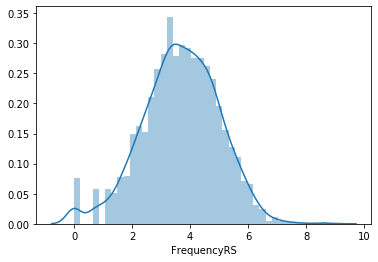

In [97]:
ax = sns.distplot(RFMScores['FrequencyRS'])

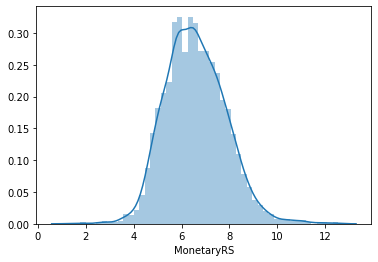

In [98]:
ax = sns.distplot(RFMScores['MonetaryRS'])

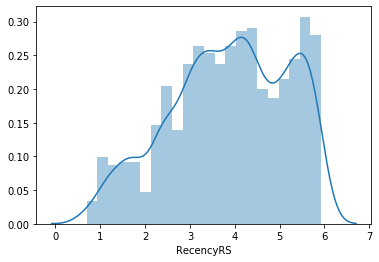

In [99]:
ax = sns.distplot(RFMScores['RecencyRS'])

In [100]:
RFMScores

,CustomerID,Recency,Frequency,Monetary,RecencyRS,FrequencyRS,MonetaryRS
0,12346.0,327,1,77183.60,5.789960,0.000000,11.253942
1,12347.0,4,182,4310.00,1.386294,5.204007,8.368693
2,12348.0,77,31,1797.24,4.343805,3.433987,7.494007
3,12349.0,20,73,1757.55,2.995732,4.290459,7.471676
4,12350.0,312,17,334.40,5.743003,2.833213,5.812338
...,...,...,...,...,...,...,...
4333,18280.0,279,10,180.60,5.631212,2.302585,5.196285
4334,18281.0,182,7,80.82,5.204007,1.945910,4.392224
4335,18282.0,9,12,178.05,2.197225,2.484907,5.182064
4336,18283.0,5,721,2045.53,1.609438,6.580639,7.623412


In [101]:
pd.set_option('display.max_rows',None)
RFMScores['RecencyRS']

0       5.789960
1       1.386294
2       4.343805
3       2.995732
4       5.743003
5       3.637586
6       5.327876
7       5.455321
8       5.375278
9       3.178054
10      3.555348
11      1.098612
12      4.077537
13      3.988984
14      5.666427
15      1.609438
16      4.709530
17      2.197225
18      5.680173
19      1.791759
20      3.970292
21      3.828641
22      4.290459
23      5.746203
24      3.295837
25      2.484907
26      5.758902
27      4.875197
28      4.418841
29      3.135494
30      1.791759
31      5.225747
32      3.401197
33      5.826000
34      2.833213
35      4.394449
36      3.135494
37      4.304065
38      4.174387
39      3.044522
40      3.610918
41      3.850148
42      4.795791
43      5.720312
44      5.783825
45      3.931826
46      5.010635
47      3.178054
48      3.931826
49      3.526361
50      4.382027
51      5.736572
52      4.330733
53      4.219508
54      5.389072
55      3.258097
56      1.609438
57      4.736198
58      4.1743

In [102]:
#mencari jumlah cluster terbaik

In [103]:
RFMScores

,CustomerID,Recency,Frequency,Monetary,RecencyRS,FrequencyRS,MonetaryRS
0,12346.0,327,1,77183.600,5.789960,0.000000,11.253942
1,12347.0,4,182,4310.000,1.386294,5.204007,8.368693
2,12348.0,77,31,1797.240,4.343805,3.433987,7.494007
3,12349.0,20,73,1757.550,2.995732,4.290459,7.471676
4,12350.0,312,17,334.400,5.743003,2.833213,5.812338
5,12352.0,38,85,2506.040,3.637586,4.442651,7.826459
6,12353.0,206,4,89.000,5.327876,1.386294,4.488636
7,12354.0,234,58,1079.400,5.455321,4.060443,6.984161
8,12355.0,216,13,459.400,5.375278,2.564949,6.129921
9,12356.0,24,59,2811.430,3.178054,4.077537,7.941449


In [104]:
X = RFMScores[['RecencyRS','FrequencyRS','MonetaryRS']]
# 'RecencyRS','FrequencyRS',

In [105]:
k = range(1, 15)
inertia = []

for i in k:
    model = KMeans(n_clusters = i)
    model.fit(X)
    inertia.append(model.inertia_)

print(k)
print(inertia)

range(1, 15)
[21880.632900465083, 11509.994898041694, 8921.558657886075, 7343.6764074627, 6247.632689436864, 5528.666364055446, 5011.9342947612795, 4621.291902980308, 4317.735707274631, 4048.099375342138, 3808.6060031607817, 3551.72487302305, 3368.8462207021394, 3233.6661330989064]


Text(0, 0.5, 'inertia sum squared error')

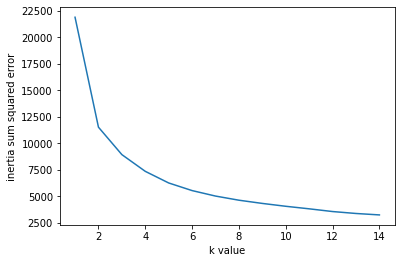

In [106]:
plt.plot(k, inertia) #melihat pada sudut siku dalam plot, mungkin sekitar 4
plt.xlabel('k value')
plt.ylabel('inertia sum squared error')

In [107]:
db,slc = {}, {}
for k in range(2, 8):
    # seed of 10 for reproducibility.
    kmeans = KMeans(n_clusters=k, max_iter=1000,random_state=10).fit(X)
    clusters = kmeans.labels_
    db[k] = davies_bouldin_score(X,clusters)
    slc[k] = silhouette_score(X,clusters)

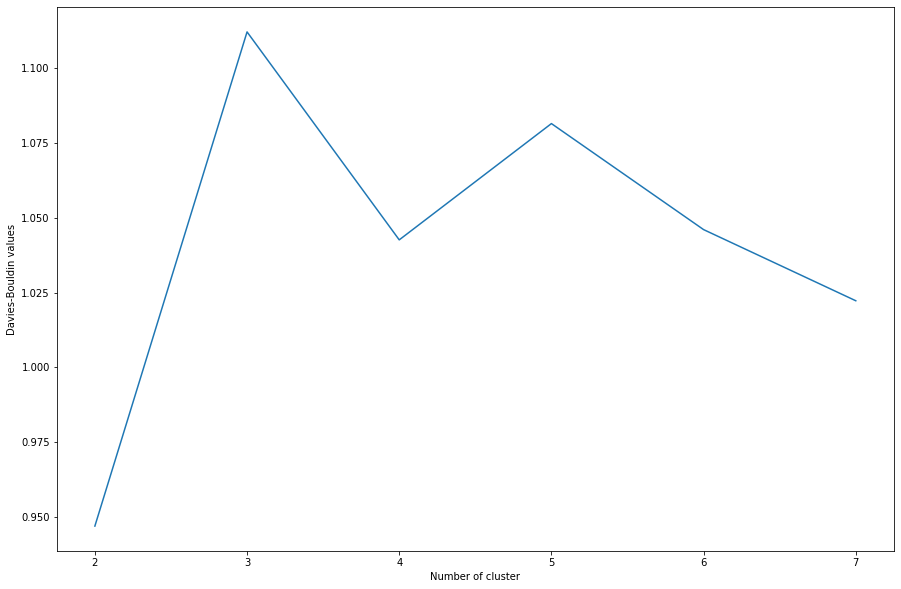

In [108]:
plt.figure(figsize=(15,10))
plt.plot(list(db.keys()), list(db.values()))
plt.xlabel("Number of cluster")
plt.ylabel("Davies-Bouldin values")
plt.show()

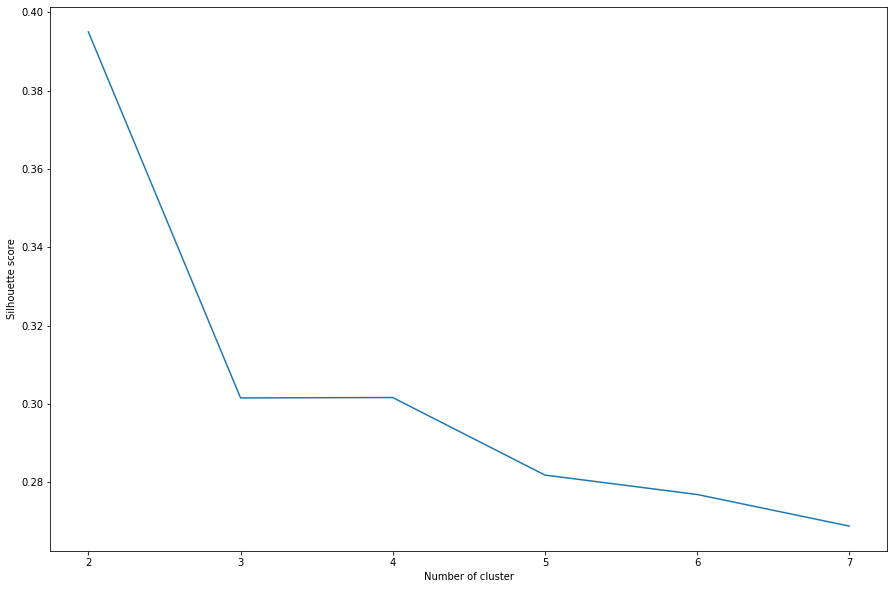

In [109]:
plt.figure(figsize=(15,10))
plt.plot(list(slc.keys()), list(slc.values()))
plt.xlabel("Number of cluster")
plt.ylabel("Silhouette score")
plt.show()

In [110]:
from sklearn.metrics import silhouette_score

In [111]:
# silhouette_score(X, model.labels_)

In [112]:
kmeans_per_k =[KMeans(n_clusters=k,random_state=100).fit(X)for k in range(2,10)]

silhouette_scores = [silhouette_score(X,model.labels_)
                    for model in kmeans_per_k[1:]]
silhouette_scores

[0.30159075770315286,
 0.3013352257558372,
 0.281987357834939,
 0.2765028442633939,
 0.2682849356765187,
 0.26448089575912614,
 0.2578223209472051]

In [113]:
# 2 cluster adalah yang terbaik,lanjut ke fitting model

In [114]:
model_KM = KMeans(n_clusters = 2, max_iter = 50000) #tingkatkan iterasi untuk meningkatkan kualitas prediksi 

model_KM.fit(RFMScores[['RecencyRS','FrequencyRS','MonetaryRS']])

KMeans(max_iter=50000, n_clusters=2)

In [115]:
model_KM.labels_

array([1, 0, 1, ..., 1, 0, 0])

In [116]:
RFMScores['cluster'] = model_KM.predict(RFMScores[['RecencyRS','FrequencyRS','MonetaryRS',]])
RFMScores.head()

,CustomerID,Recency,Frequency,Monetary,RecencyRS,FrequencyRS,MonetaryRS,cluster
0,12346.0,327,1,77183.60,5.789960,0.000000,11.253942,1
1,12347.0,4,182,4310.00,1.386294,5.204007,8.368693,0
2,12348.0,77,31,1797.24,4.343805,3.433987,7.494007,1
3,12349.0,20,73,1757.55,2.995732,4.290459,7.471676,0
4,12350.0,312,17,334.40,5.743003,2.833213,5.812338,1


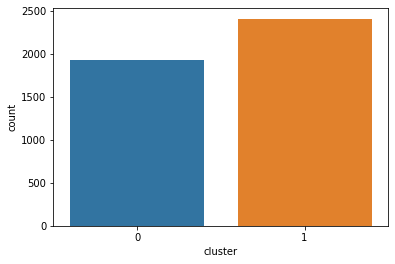

In [117]:
sns.countplot(RFMScores['cluster'])

In [118]:
K0=RFMScores[RFMScores['cluster']==0]
K0

,CustomerID,Recency,Frequency,Monetary,RecencyRS,FrequencyRS,MonetaryRS,cluster
1,12347.0,4,182,4310.000,1.386294,5.204007,8.368693,0
3,12349.0,20,73,1757.550,2.995732,4.290459,7.471676,0
5,12352.0,38,85,2506.040,3.637586,4.442651,7.826459,0
9,12356.0,24,59,2811.430,3.178054,4.077537,7.941449,0
10,12357.0,35,131,6207.670,3.555348,4.875197,8.733541,0
11,12358.0,3,19,1168.060,1.098612,2.944439,7.063100,0
12,12359.0,59,245,6310.030,4.077537,5.501258,8.749896,0
13,12360.0,54,129,2662.060,3.988984,4.859812,7.886856,0
15,12362.0,5,266,5226.230,1.609438,5.583496,8.561445,0
17,12364.0,9,85,1313.100,2.197225,4.442651,7.180146,0


In [119]:
K1=RFMScores[RFMScores['cluster']==1]
K1

,CustomerID,Recency,Frequency,Monetary,RecencyRS,FrequencyRS,MonetaryRS,cluster
0,12346.0,327,1,77183.600,5.789960,0.000000,11.253942,1
2,12348.0,77,31,1797.240,4.343805,3.433987,7.494007,1
4,12350.0,312,17,334.400,5.743003,2.833213,5.812338,1
6,12353.0,206,4,89.000,5.327876,1.386294,4.488636,1
7,12354.0,234,58,1079.400,5.455321,4.060443,6.984161,1
8,12355.0,216,13,459.400,5.375278,2.564949,6.129921,1
14,12361.0,289,10,189.900,5.666427,2.302585,5.246498,1
16,12363.0,111,23,552.000,4.709530,3.135494,6.313548,1
18,12365.0,293,22,641.380,5.680173,3.091042,6.463622,1
19,12367.0,6,11,168.900,1.791759,2.397895,5.129307,1


In [120]:
K1.shape

(2411, 8)

In [121]:
K0.shape

(1927, 8)

In [122]:
RFMScores1=RFMScores[RFMScores['Frequency']<1000]
RFMScores1

,CustomerID,Recency,Frequency,Monetary,RecencyRS,FrequencyRS,MonetaryRS,cluster
0,12346.0,327,1,77183.600,5.789960,0.000000,11.253942,1
1,12347.0,4,182,4310.000,1.386294,5.204007,8.368693,0
2,12348.0,77,31,1797.240,4.343805,3.433987,7.494007,1
3,12349.0,20,73,1757.550,2.995732,4.290459,7.471676,0
4,12350.0,312,17,334.400,5.743003,2.833213,5.812338,1
5,12352.0,38,85,2506.040,3.637586,4.442651,7.826459,0
6,12353.0,206,4,89.000,5.327876,1.386294,4.488636,1
7,12354.0,234,58,1079.400,5.455321,4.060443,6.984161,1
8,12355.0,216,13,459.400,5.375278,2.564949,6.129921,1
9,12356.0,24,59,2811.430,3.178054,4.077537,7.941449,0


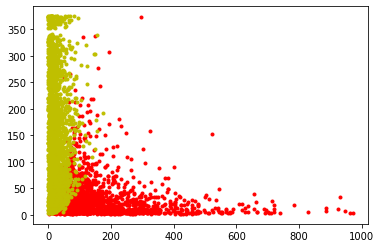

In [123]:
plt.plot(RFMScores1['Frequency'][RFMScores1['cluster'] ==0], RFMScores1['Recency'][RFMScores1['cluster'] ==0], 'r.')
plt.plot(RFMScores1['Frequency'][RFMScores1['cluster'] ==1], RFMScores1['Recency'][RFMScores1['cluster'] ==1], 'y.')

Cluster 0 kebanyakan has high recency rate, which means it's been the longest for any cluster when it comes to Last Purchase Date.
CLuster 1 have middle recency and low recency rate, which is good. They can be our Best Customers.

lalu kita ingin tau berapa persen sih dari setiap cluster kontribusinya terhadap pendapatan perusahaan.

In [124]:
RFMScores

,CustomerID,Recency,Frequency,Monetary,RecencyRS,FrequencyRS,MonetaryRS,cluster
0,12346.0,327,1,77183.600,5.789960,0.000000,11.253942,1
1,12347.0,4,182,4310.000,1.386294,5.204007,8.368693,0
2,12348.0,77,31,1797.240,4.343805,3.433987,7.494007,1
3,12349.0,20,73,1757.550,2.995732,4.290459,7.471676,0
4,12350.0,312,17,334.400,5.743003,2.833213,5.812338,1
5,12352.0,38,85,2506.040,3.637586,4.442651,7.826459,0
6,12353.0,206,4,89.000,5.327876,1.386294,4.488636,1
7,12354.0,234,58,1079.400,5.455321,4.060443,6.984161,1
8,12355.0,216,13,459.400,5.375278,2.564949,6.129921,1
9,12356.0,24,59,2811.430,3.178054,4.077537,7.941449,0


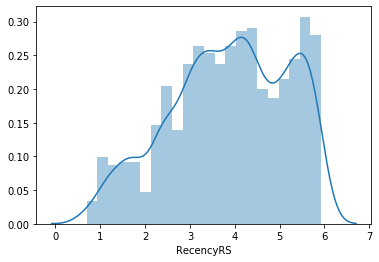

In [125]:
ax = sns.distplot(RFMScores['RecencyRS'])

In [126]:
total=RFMScores['Monetary']
total

0        77183.600
1         4310.000
2         1797.240
3         1757.550
4          334.400
5         2506.040
6           89.000
7         1079.400
8          459.400
9         2811.430
10        6207.670
11        1168.060
12        6310.030
13        2662.060
14         189.900
15        5226.230
16         552.000
17        1313.100
18         641.380
19         168.900
20        3541.940
21        1887.960
22        1298.040
23         364.600
24         742.930
25         457.500
26        1628.120
27        4008.620
28         852.240
29        2724.810
30        1845.310
31        1850.560
32         585.270
33         401.900
34        2780.660
35         549.840
36         439.660
37        1582.600
38        1272.480
39        3018.630
40        2409.900
41        1635.660
42        1108.650
43          84.300
44         225.600
45         427.700
46        1710.390
47        3415.300
48        1708.120
49        2888.550
50       11072.670
51         693.330
52        12

In [127]:
df = pd.DataFrame(total)
df

,Monetary
0,77183.600
1,4310.000
2,1797.240
3,1757.550
4,334.400
5,2506.040
6,89.000
7,1079.400
8,459.400
9,2811.430


In [128]:
#Total sum per column: 
df.loc['Total',:]= df.sum(axis=0)
df

# #Total sum per row: 
# df.loc[:,'Total'] = df.sum(axis=1)

,Monetary
0,77183.600
1,4310.000
2,1797.240
3,1757.550
4,334.400
5,2506.040
6,89.000
7,1079.400
8,459.400
9,2811.430


In [129]:
df.loc['Total']

Monetary    8887208.894
Name: Total, dtype: float64

In [130]:
K1

,CustomerID,Recency,Frequency,Monetary,RecencyRS,FrequencyRS,MonetaryRS,cluster
0,12346.0,327,1,77183.600,5.789960,0.000000,11.253942,1
2,12348.0,77,31,1797.240,4.343805,3.433987,7.494007,1
4,12350.0,312,17,334.400,5.743003,2.833213,5.812338,1
6,12353.0,206,4,89.000,5.327876,1.386294,4.488636,1
7,12354.0,234,58,1079.400,5.455321,4.060443,6.984161,1
8,12355.0,216,13,459.400,5.375278,2.564949,6.129921,1
14,12361.0,289,10,189.900,5.666427,2.302585,5.246498,1
16,12363.0,111,23,552.000,4.709530,3.135494,6.313548,1
18,12365.0,293,22,641.380,5.680173,3.091042,6.463622,1
19,12367.0,6,11,168.900,1.791759,2.397895,5.129307,1


In [131]:
dfK1 = pd.DataFrame(K1['Monetary'])
dfK1

,Monetary
0,77183.600
2,1797.240
4,334.400
6,89.000
7,1079.400
8,459.400
14,189.900
16,552.000
18,641.380
19,168.900


In [132]:
dfK1.loc['Total',:]= dfK1.sum(axis=0)
dfK1


,Monetary
0,77183.600
2,1797.240
4,334.400
6,89.000
7,1079.400
8,459.400
14,189.900
16,552.000
18,641.380
19,168.900


In [133]:
dfK1.loc['Total']

Monetary    1192662.902
Name: Total, dtype: float64

In [134]:
dfK0 = pd.DataFrame(K0['Monetary'])
dfK0

,Monetary
1,4310.000
3,1757.550
5,2506.040
9,2811.430
10,6207.670
11,1168.060
12,6310.030
13,2662.060
15,5226.230
17,1313.100


In [135]:
dfK0.loc['Total',:]= dfK0.sum(axis=0)
dfK0

,Monetary
1,4310.000
3,1757.550
5,2506.040
9,2811.430
10,6207.670
11,1168.060
12,6310.030
13,2662.060
15,5226.230
17,1313.100


In [136]:
print(K1.shape)
print(K0.shape)

(2411, 8)
(1927, 8)


In [137]:
print(df.loc['Total'])
print(dfK1.loc['Total'])
print(dfK0.loc['Total'])

Monetary    8887208.894
Name: Total, dtype: float64
Monetary    1192662.902
Name: Total, dtype: float64
Monetary    7694545.992
Name: Total, dtype: float64


In [2]:
K1persen=(1177916.032/8887208.894)*100
K1persen

13.254060369788807

In [3]:
K1persen/2411

0.005497329062542019

In [4]:
K0persen=(7709292.862/8887208.894)*100
K0persen

86.7459396302112

In [5]:
K0persen/1927

0.04501605585376814

In [142]:
#artinya kalo kita kehilangan 1 saja pelanggan kita di cluster 1,kita kehilangan sekitar 1,9 persen pendapatan kita.

In [143]:
RFMScores

,CustomerID,Recency,Frequency,Monetary,RecencyRS,FrequencyRS,MonetaryRS,cluster
0,12346.0,327,1,77183.600,5.789960,0.000000,11.253942,1
1,12347.0,4,182,4310.000,1.386294,5.204007,8.368693,0
2,12348.0,77,31,1797.240,4.343805,3.433987,7.494007,1
3,12349.0,20,73,1757.550,2.995732,4.290459,7.471676,0
4,12350.0,312,17,334.400,5.743003,2.833213,5.812338,1
5,12352.0,38,85,2506.040,3.637586,4.442651,7.826459,0
6,12353.0,206,4,89.000,5.327876,1.386294,4.488636,1
7,12354.0,234,58,1079.400,5.455321,4.060443,6.984161,1
8,12355.0,216,13,459.400,5.375278,2.564949,6.129921,1
9,12356.0,24,59,2811.430,3.178054,4.077537,7.941449,0


# lalu selanjutnya kita membagi lagi setiap cluster secara terperinci

In [144]:
#Split into four segments using quantiles
quantiles = RFMScores.quantile(q=[0.25,0.5,0.75])
quantiles = quantiles.to_dict()
quantiles

{'Recency': {0.25: 19.0, 0.5: 52.0, 0.75: 143.75},
 'Frequency': {0.25: 17.0, 0.5: 41.0, 0.75: 98.0},
 'Monetary': {0.25: 306.48249999999996,
  0.5: 668.5700000000002,
  0.75: 1660.5974999999999},
 'RecencyRS': {0.25: 2.9444389791664403,
  0.5: 3.9512437185814275,
  0.75: 4.968071132246978},
 'FrequencyRS': {0.25: 2.833213344056216,
  0.5: 3.713572066704308,
  0.75: 4.584967478670572},
 'MonetaryRS': {0.25: 5.725160649414697,
  0.5: 6.505141102990099,
  0.75: 7.414932712926037},
 'cluster': {0.25: 0.0, 0.5: 1.0, 0.75: 1.0}}

In [145]:
## bikin fungsi buat labelin per segmen berdasarkan RFM.kalo Rscoring itu buat Recency karena semakin kecil makin dapet kelas 4 atau semakin banyak RFMnya,semakin banyak RFM semakin loyal atau semakin bagus customernya

In [146]:
#Functions to create R, F and M segments
def RScoring(x,p,d):
    if x <= d[p][0.25]:
        return 4
    elif x <= d[p][0.50]:
        return 3
    elif x <= d[p][0.75]: 
        return 2
    else:
        return 1
    
def FnMScoring(x,p,d):
    if x <= d[p][0.25]:
        return 1
    elif x <= d[p][0.50]:
        return 2
    elif x <= d[p][0.75]: 
        return 3
    else:
        return 4


In [147]:
#Calculate Add R, F and M segment value columns in the existing dataset to show R, F and M segment values
RFMScores['R'] = RFMScores['Recency'].apply(RScoring, args=('Recency',quantiles,))
RFMScores['F'] = RFMScores['Frequency'].apply(FnMScoring, args=('Frequency',quantiles,))
RFMScores['M'] = RFMScores['Monetary'].apply(FnMScoring, args=('Monetary',quantiles,))
RFMScores.head()


,CustomerID,Recency,Frequency,Monetary,RecencyRS,FrequencyRS,MonetaryRS,cluster,R,F,M
0,12346.0,327,1,77183.60,5.789960,0.000000,11.253942,1,1,1,4
1,12347.0,4,182,4310.00,1.386294,5.204007,8.368693,0,4,4,4
2,12348.0,77,31,1797.24,4.343805,3.433987,7.494007,1,2,2,4
3,12349.0,20,73,1757.55,2.995732,4.290459,7.471676,0,3,3,4
4,12350.0,312,17,334.40,5.743003,2.833213,5.812338,1,1,1,2


In [148]:
#gabungi RFMnya biar enak diliat

In [149]:
RFMScores['RFMGroup'] = RFMScores.R.map(str) + RFMScores.F.map(str) + RFMScores.M.map(str)


In [150]:
RFMScores.head()

,CustomerID,Recency,Frequency,Monetary,RecencyRS,FrequencyRS,MonetaryRS,cluster,R,F,M,RFMGroup
0,12346.0,327,1,77183.60,5.789960,0.000000,11.253942,1,1,1,4,114
1,12347.0,4,182,4310.00,1.386294,5.204007,8.368693,0,4,4,4,444
2,12348.0,77,31,1797.24,4.343805,3.433987,7.494007,1,2,2,4,224
3,12349.0,20,73,1757.55,2.995732,4.290459,7.471676,0,3,3,4,334
4,12350.0,312,17,334.40,5.743003,2.833213,5.812338,1,1,1,2,112


In [151]:
#Calculate and Add RFMScore value column showing total sum of RFMGroup values
RFMScores['RFMScore'] = RFMScores[['R', 'F', 'M']].sum(axis = 1)
RFMScores.head()

,CustomerID,Recency,Frequency,Monetary,RecencyRS,FrequencyRS,MonetaryRS,cluster,R,F,M,RFMGroup,RFMScore
0,12346.0,327,1,77183.60,5.789960,0.000000,11.253942,1,1,1,4,114,6
1,12347.0,4,182,4310.00,1.386294,5.204007,8.368693,0,4,4,4,444,12
2,12348.0,77,31,1797.24,4.343805,3.433987,7.494007,1,2,2,4,224,8
3,12349.0,20,73,1757.55,2.995732,4.290459,7.471676,0,3,3,4,334,10
4,12350.0,312,17,334.40,5.743003,2.833213,5.812338,1,1,1,2,112,4


ada dua cara cara bacanya,kita bisa liat pertama dari RFM score,cuman RFM sroe ga menggambarkan terlalu detail,makanya perlu kita bedah lagi

In [152]:
import re

In [153]:
segt_map = {
    r'[1-2][1-2]': 'Hibernating',
    r'[1-2][2-3]': 'At risk',
    r'[1-2]4': 'Cannot loose them',
    r'2[1-2]': 'About to sleep',
    r'22': 'Need attention',
    r'[2-3][3-4]': 'Loyal customers',
    r'[3-4]1': 'Promising New customers',
    r'[3-4]2': 'Potential loyalists',
    r'4[3-4]': 'Champions'
}

RFMScores['Segment'] = RFMScores['R'].map(str) + RFMScores['F'].map(str)
RFMScores['Segment'] = RFMScores['Segment'].replace(segt_map, regex=True)
RFMScores

,CustomerID,Recency,Frequency,Monetary,RecencyRS,FrequencyRS,MonetaryRS,cluster,R,F,M,RFMGroup,RFMScore,Segment
0,12346.0,327,1,77183.600,5.789960,0.000000,11.253942,1,1,1,4,114,6,Hibernating
1,12347.0,4,182,4310.000,1.386294,5.204007,8.368693,0,4,4,4,444,12,Champions
2,12348.0,77,31,1797.240,4.343805,3.433987,7.494007,1,2,2,4,224,8,Hibernating
3,12349.0,20,73,1757.550,2.995732,4.290459,7.471676,0,3,3,4,334,10,Loyal customers
4,12350.0,312,17,334.400,5.743003,2.833213,5.812338,1,1,1,2,112,4,Hibernating
5,12352.0,38,85,2506.040,3.637586,4.442651,7.826459,0,3,3,4,334,10,Loyal customers
6,12353.0,206,4,89.000,5.327876,1.386294,4.488636,1,1,1,1,111,3,Hibernating
7,12354.0,234,58,1079.400,5.455321,4.060443,6.984161,1,1,3,3,133,7,At risk
8,12355.0,216,13,459.400,5.375278,2.564949,6.129921,1,1,1,2,112,4,Hibernating
9,12356.0,24,59,2811.430,3.178054,4.077537,7.941449,0,3,3,4,334,10,Loyal customers


In [154]:
RFMScores['Segment']

0                   Hibernating
1                     Champions
2                   Hibernating
3               Loyal customers
4                   Hibernating
5               Loyal customers
6                   Hibernating
7                       At risk
8                   Hibernating
9               Loyal customers
10              Loyal customers
11          Potential loyalists
12            Cannot loose them
13            Cannot loose them
14                  Hibernating
15                    Champions
16                  Hibernating
17                    Champions
18                  Hibernating
19      Promising New customers
20            Cannot loose them
21              Loyal customers
22                      At risk
23                  Hibernating
24          Potential loyalists
25      Promising New customers
26                      At risk
27            Cannot loose them
28                  Hibernating
29              Loyal customers
30                    Champions
31      

In [155]:
segment= RFMScores['Segment']

(array([0, 1, 2, 3, 4, 5, 6]), <a list of 7 Text xticklabel objects>)

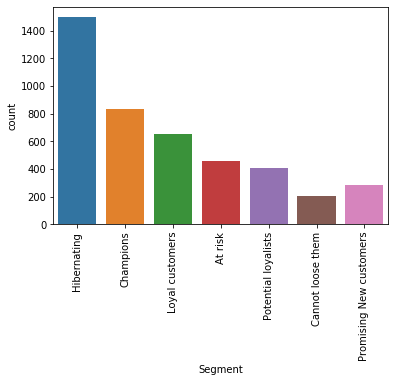

In [156]:
ax = sns.countplot(RFMScores['Segment'])
plt.xticks(rotation = 90)

In [157]:
results=RFMScores.groupby('Segment').sum()
results

,Recency,Frequency,Monetary,RecencyRS,FrequencyRS,MonetaryRS,cluster,R,F,M,RFMScore
Segment,,,,,,,,,,,
At risk,63341,29045,496146.450,2188.320986,1889.640399,3075.357614,320,752,1377,1226,3355
Cannot loose them,22062,32288,490661.791,926.895808,1020.114408,1539.366944,20,362,816,723,1901
Champions,7872,202192,4815656.330,1719.531225,4200.455943,6517.937363,6,3340,3052,2935,9327
Hibernating,276121,25943,828638.062,7574.681960,3837.267764,8572.001912,1483,2125,2174,2556,6855
Loyal customers,20992,88872,1653832.141,2234.725420,3044.403645,4741.355519,55,1950,2279,2087,6316
Potential loyalists,10190,11644,299491.910,1212.996839,1345.968128,2528.590634,255,1374,808,879,3061
Promising New customers,7452,2708,302782.210,875.348272,589.212990,1594.175296,272,967,287,439,1693


In [158]:
results = results.reset_index()

In [159]:
results

,Segment,Recency,Frequency,Monetary,RecencyRS,FrequencyRS,MonetaryRS,cluster,R,F,M,RFMScore
0,At risk,63341,29045,496146.450,2188.320986,1889.640399,3075.357614,320,752,1377,1226,3355
1,Cannot loose them,22062,32288,490661.791,926.895808,1020.114408,1539.366944,20,362,816,723,1901
2,Champions,7872,202192,4815656.330,1719.531225,4200.455943,6517.937363,6,3340,3052,2935,9327
3,Hibernating,276121,25943,828638.062,7574.681960,3837.267764,8572.001912,1483,2125,2174,2556,6855
4,Loyal customers,20992,88872,1653832.141,2234.725420,3044.403645,4741.355519,55,1950,2279,2087,6316
5,Potential loyalists,10190,11644,299491.910,1212.996839,1345.968128,2528.590634,255,1374,808,879,3061
6,Promising New customers,7452,2708,302782.210,875.348272,589.212990,1594.175296,272,967,287,439,1693


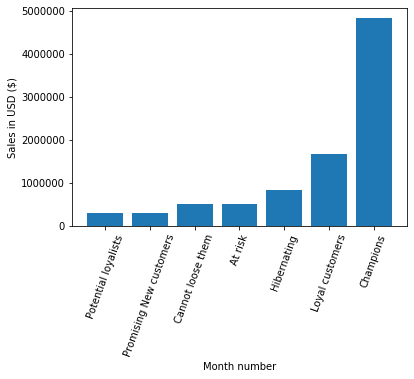

In [160]:
hasil = results.sort_values(by='Monetary')
plt.bar(hasil['Segment'],hasil['Monetary'])
plt.xticks(results['Segment'])
plt.ylabel('Sales in USD ($)')
plt.xlabel('Month number')
plt.xticks(rotation=70)
plt.show()

In [161]:
#terserah kita mau bagi 4 segmen atau 5 segmen
#ini RFM score semakin jumlahnya kecil semakin bagus

#kita lihat cluster umum dan khususnya yang terbaru

In [162]:
# kita save clustering kita

In [163]:
#Ubah cluster 1,0 = jadi A,B

In [166]:
RFMScores.loc[RFMScores['cluster']==0, 'cluster'] = 'A'
RFMScores.loc[RFMScores['cluster']==1, 'cluster'] = 'B'
pd.set_option('display.max_rows', None)
RFMScores

,CustomerID,Recency,Frequency,Monetary,RecencyRS,FrequencyRS,MonetaryRS,cluster,R,F,M,RFMGroup,RFMScore,Segment
0,12346.0,327,1,77183.600,5.789960,0.000000,11.253942,B,1,1,4,114,6,Hibernating
1,12347.0,4,182,4310.000,1.386294,5.204007,8.368693,A,4,4,4,444,12,Champions
2,12348.0,77,31,1797.240,4.343805,3.433987,7.494007,B,2,2,4,224,8,Hibernating
3,12349.0,20,73,1757.550,2.995732,4.290459,7.471676,A,3,3,4,334,10,Loyal customers
4,12350.0,312,17,334.400,5.743003,2.833213,5.812338,B,1,1,2,112,4,Hibernating
5,12352.0,38,85,2506.040,3.637586,4.442651,7.826459,A,3,3,4,334,10,Loyal customers
6,12353.0,206,4,89.000,5.327876,1.386294,4.488636,B,1,1,1,111,3,Hibernating
7,12354.0,234,58,1079.400,5.455321,4.060443,6.984161,B,1,3,3,133,7,At risk
8,12355.0,216,13,459.400,5.375278,2.564949,6.129921,B,1,1,2,112,4,Hibernating
9,12356.0,24,59,2811.430,3.178054,4.077537,7.941449,A,3,3,4,334,10,Loyal customers


In [167]:
RFMScores

,CustomerID,Recency,Frequency,Monetary,RecencyRS,FrequencyRS,MonetaryRS,cluster,R,F,M,RFMGroup,RFMScore,Segment
0,12346.0,327,1,77183.600,5.789960,0.000000,11.253942,B,1,1,4,114,6,Hibernating
1,12347.0,4,182,4310.000,1.386294,5.204007,8.368693,A,4,4,4,444,12,Champions
2,12348.0,77,31,1797.240,4.343805,3.433987,7.494007,B,2,2,4,224,8,Hibernating
3,12349.0,20,73,1757.550,2.995732,4.290459,7.471676,A,3,3,4,334,10,Loyal customers
4,12350.0,312,17,334.400,5.743003,2.833213,5.812338,B,1,1,2,112,4,Hibernating
5,12352.0,38,85,2506.040,3.637586,4.442651,7.826459,A,3,3,4,334,10,Loyal customers
6,12353.0,206,4,89.000,5.327876,1.386294,4.488636,B,1,1,1,111,3,Hibernating
7,12354.0,234,58,1079.400,5.455321,4.060443,6.984161,B,1,3,3,133,7,At risk
8,12355.0,216,13,459.400,5.375278,2.564949,6.129921,B,1,1,2,112,4,Hibernating
9,12356.0,24,59,2811.430,3.178054,4.077537,7.941449,A,3,3,4,334,10,Loyal customers


# Rangkuman dan rekomendasi

Berdasarkan hasil clustering kita tadi menggunakan K-means,kita mendapatkan 2 cluster yaitu cluster A dan cluster B,yang mana cluster A memiliki nilai recency yang rendah dan frequency pembelian yang tinggi,sementara cluster B memiliki recency yang tinggi dan frequency yang cenderung rendah,dalam hal ini jika nilai frequency tinggi maka itu baik untuk perusahaan,namun jika nilai recency nya yang tinggi ini kurang baik bagi perusahaan,karena si customer ini sudah lama tidak belanja di kita,dalam hal ini maka cluster A memiliki nilai R dan F yang lebih baik dibandingkan cluster B,kemudia setelah kita analisis juga cluster A memiliki dampak terhadap revenue perusahaan sebesar 86 persen sementara cluster B hanya sekitar 13 persen.Cluster A memiliki jumlah customer sebanyak 1945 customer sementara clsuter B memiliki sebanyak 2941 customer,jika kita itung kontribusi setiap custtomer terhadap revenue perusahaan,customer di cluster A memiliki kontribusi sebesar 0,05 persen setiap customernya,sementara cluster B sekitar 0,00 persen,yang mana ini menggambarkan bahwa bila kita kehilangan satu saja customer di cluster A akan menyebabkan kehilangan 0,00 persen pendapatan perusahaan,bisa kita lihat dan simpulkan cluster A memiliki nilai RFM yang lebih baik dari cluster B,sehingga saya katakan cluster A ini sangat berharaga atau dalam skala prioritas lebih harus di maximalkan,namun kita tetap harus memerhatikan cluster B.bagaimana caranya agar cluster A tetap ter maintain dan ornag orang di cluster B bisa masuk ke kategori cluster A.Cluster A dan B juga dapat saya rekomendasikan dalam pembuatan kartu keanggotaan,jadi setiap customer nanti memiliki kartu yang mana kartu tersebut berisi informasi ada di mana dia di suatu cluster,yang akan terus terupdate setiap bulannya,karena sangat berharganya cluster A,maka dari itu keanggotan kartunya saya ibaratnya dengan vvip atau annual pass yang ada di dufan,jadi customer di cluster A akan mendapatakan berbagai macam kemudahan dan pelayanan yang lebih,contoh misalkan customer di cluster A dapat mengikuti dorrprize undian mobila tau motor yang diadakan perusahaan setiap 1 tahun sekali,dan jika ulang tahun customer di cluster A dapat gratis atau potongan dalam membeli produknya,dan lain lian.berbagai kemudahan tadi akan membuat customer di cluster B menjadi terpacu dan ingin juga masuk ke cluster A,maka dari itu ini berdampak baik bagi perusahaan kedepannya.dan ini juga dapat dijadikan acuan oleh perusahaan di departemen R&D dalam melakukan riset dan pengembangan produk lebih condong ke cluster A.
Setelah membagi dengan k-means,saya juga membagi secara lebih detail berdasarkan R dan F score ,ada 9 segment.yang mana karakteristik dan perlakuan yang diberikan untuk setiap customer tentunya berbeda beda.
1. Hibernating
karakteristik=customer ini memiliki nilai R dan F score yang sengat rendah,artinya mereka udah lama ga beli dikita,dan mereka baru beli sekali atau dua kali,baru sedikit ordernya
Skala priortias = serius
Perlakuannya= tawarkan produk yang pernah di beli dulu atau yang relevan atau yang mirip,jangan sampai kehilangan segment ini,karen dari paper yang saya baca,biaya akuisi untuk mendapatkan customer baru biayanya lebih tinggi 3–4 kali lipat dari biaya mempertahankan customer,maka dari itu jangan sampe segmeng ini keluar atau pindah dari perusahaan kita.
2. At risk
karakteristik=customer ini memiliki nilai R yang rendah dan F score rata rata atau tenga tengah,artinya mereka udah lama ga beli dikita,dan mereka tapi mereka frequency belinya lebih serig dibanding dengan customer hibernating
Skala priortias = diatas hibernating.AT risk karena dalam bahaya karena dia mendekati hibernating,jangan sampe dia turun segment.
Perlakuannya= tawarkan produk yang pernah di beli dulu atau yang relevan atau yang mirip,biaya marketing untuk segment ini dapat dialokasikan lebih besar dibanding customer hibernating,karena probnya untuk membeli produk kita lagi lebih besar.
3. Cannot Lose them
karakteristik=customer ini memiliki nilai R yang rendah namun F scoreny a tinggi banget,artinya mereka udah lama ga beli dikita,tapi dulu mereka beli sering banget nih di kita,artinya dulu loyal sekrang udah agak jarang dikita,kenapa nih
Skala priortias = diatas HIbernating dan At risk.
Perlakuannya= perlu kita perhatikan lagi nih,kita jalin komunikasi lagi,dan menanyakan kabar dan merekoemndasikan produk serta mengirimkan survey dan review terhdap produk pesanan kita yang dahulu,yang hasilnya dapat menjadi evaluasi kita,misalkan ada barang yang yang kurang bagus kualitasnya atau ada pelayanan yang kurang bagus yang membuat yang awalnay sering beli dikita menjadi agak jarang,ini bisa menajdi bahan evaluasi kta baik di peningkatan produk maupun peningkatan pelayanan SDM.
4. About to sleep
karakteristik=customer ini memiliki nilai R yang tengah tengah namun F scorenya rendah,artinya ga terlalu lama baru beli dikita,tapi dulu belinya ga sering frekuensinya
Skala priortias = sama dengan At risk.,jangan sampe customer ini turun ke hibernating
Perlakuannya= kita perlau bangunkan kembali dia dari ngantuknya,tawarkan prduk populer dan tawarkan diskon.
5. Need atention
karakteristik=customer ini memiliki nilai R yang tengah tengah dan R Scorenya tengah tengah juga,dalam plot customer ini ada diperbatasan antara cluster A dan B
Skala priortias = cukup serius
Perlakuannya= karena customer ini ada di perbatasan cluster A dan cluster B.maka tugas kita dalah membawa mereka kedalam cluster A,jangan sampai turun segment,tawarkan produk yang mereka suka beli,lakukan cross sell,atau jual produk komplementer dari produk yang mereka beli,dan beri tahu kemudahan bila masuk ke cluster A,sehingga merek lebih terpacu.
6. Loyal Customer
karakteristik=customer ini sering beli dikita dan suka banet ama produk kita,makanya kita kasih nama loyal,recency luamayan,frequency sering banget
Skala priortias = cukup
Perlakuannya= tipe customer ini sangat loyal terhdap produk kita dan sudah percaya dnegan produk kita,tipe tipe customer ini adalah tipe yang sangat tertarik dengan promo dan diskon,dan karena dia loyal kita juga bis amemebrikan reward bagi dia apabila dia merekomendasikan atau dapat mengajak temannya untuk membeli produk di kita.
7. Promising new customer
karakteristik=Customer ini ibaratnya pendatang baru di toko kita,belinya recencynya baru baru ini,baru baru sekali beli,apalagi kalo customer ini ada di cluster A,wah sangat menjanjikan sekali,berati reveneu yang dia berika ke perusahaan cukup besar dan menjanjikan.
Skala priortias = serius
Perlakuannya=customer ini first time buyer ibarat,pdkt ke csutomer,harus diperlakukan hati hati,saat di menjadi fisrt time buyer,kita mendapatkan bebrapa informasi detail mereka.sepeerti kontak hp,email,nah disini lah kita mulai pdktnya,kita gali lebih dalam behaviournya kita lihat riwayat kunjungan ke website kita lebih sering liat produk apa,kita berikan email terima aksih dan selamat bergabung di toko kita,kita kirim email feedback untuk review produk dan pelayanan kita,kita rekomendasi produk yang dia sukai,intinya bagaimana mendapat kan perhatian lebih dari customer ini karena harus dijaga dan sangat menjanjikan.
8. Potential loyalist
karakteristik=customer ini akhir akhir ini suka beli dikita,dan frequency belinya rata rata,atau suka beli namun tidak sesering loyal customer.
Skala priortias = cukup serius
Perlakuannya=tipe customer ini berpotensi untuk sangat loyal, terhdap produk kita dan sudah percaya dnegan produk kita,tipe tipe customer ini adalah tipe yang sangat tertarik dengan promo dan diskon,dan karena dia loyal kita juga bis amemebrikan reward bagi dia apabila dia merekomendasikan atau dapat mengajak temannya untuk membeli produk di kita.
9. Champions
karakteristik= customer juara banget,sering banget beli dikita,loyal paling loyal
Skala priortias = cukup
Perlakuannya=tipe customer ini harus sering sering kit aberikan reward dan keistimewaan khusus,kelas vvip ini ibaratnya.kalo ulang tahun kita berikan hadiah dan ucapan,dan bisa dapet potongan diskon,atau bisa berikan kemudahan dalam hal pembyaran,bisa dicicil.

In [168]:
K1.to_csv('K1.csv')

In [169]:
K0.to_csv('K0.csv')

In [170]:
RFMScores.to_csv('Cluster.csv')

In [171]:
data.to_csv('datasiap.csv')